# Acoustic and Visual Data Preprocessing

In [1]:
import os
from glob import glob
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from tqdm import tqdm
%matplotlib inline

## Path setup

In [2]:
here = os.getcwd()

video_dir = os.path.join(here, "data")
audio_dir = os.path.join(video_dir, "audios")
audio_features_dir = os.path.join(video_dir, "audio_features")
face_features_dir = os.path.join(video_dir, "face_features")

figures_dir = os.path.join(here, "figures", "lab1")
merged_features_dir = os.path.join(video_dir, "merged_features")

video_ids = [os.path.split(file)[1][:-4] for file in glob(os.path.join(video_dir, "*.mp4"))]

In [3]:
video_ids

['k4vzhweOefs',
 'lr-mXnUoUXM',
 'O6jrLgvCUNs',
 'ovKqmRyOGcg',
 'psN1DORYYV0',
 'tZYkjaKNr_o',
 'XE_FPEFpHt4',
 'yCm9Ng0bbEQ',
 'zawpbVpu5nY',
 'ZdDjexbxVzM']

## Feature reading & visualization functions

### Video

In [4]:
def read_face_features(video_id):
    csv_path = os.path.join(face_features_dir, f"{video_id}.csv")
    df = pd.read_csv(csv_path, 
                     sep=",", 
                     dtype={
                         "frame": int,
                         " face_id": int,
                         " success": int})
    # Remove spaces from column names
    df.columns = df.columns.str.strip()
    
    return df

def plot_AU(df, video_id, plot_window=None, AU='01_r', median_filters=[3, 5, 7]):
    
    au_col = f'AU{AU}'
    
    # Filter by frame window, recover only AU of interest
    if plot_window is not None:
        au_raw = df[(df['frame'] >= plot_window[0]) & (df['frame'] <= plot_window[1])][au_col]
    else:
        au_raw = df[au_col]
    
    # Compute median filters if specified
    filters = []
    for window_size in median_filters:
        filters.append(au_raw.rolling(window_size, center=True).median())
    
    # Make plot
    fig, ax = plt.subplots(figsize=(15, 6), tight_layout=True, dpi=400.0, facecolor='white')
    
    # Plot raw series and eventual filters
    ax.plot(au_raw, label=f'raw')
    for i, fil in enumerate(filters):
        ax.plot(fil, label=f'{median_filters[i]} median filter')
    
    # Fill plot legends, title, labels
    ax.legend()
    if plot_window is not None:
        ax.set_title(f'{au_col} in video {video_id} (frames {plot_window[0]}-{plot_window[1]})')
    else:
        ax.set_title(f'{au_col} in video {video_id}')
    ax.set_ylabel('Magnitude')
    ax.set_xlabel('Frame')
    
    # Strings for filename encoding
    med_string = '-'.join(map(str, median_filters))
    if plot_window is not None:
        fr_string = '-'.join(map(str, plot_window))
    else:
        fr_string = ''
    
    # Make filename to save png
    plot_fname = f'{video_id}__{au_col}__m{med_string}__f{fr_string}.png'
    
    # Check figures_dir exists and make it otherwise
    os.makedirs(figures_dir, exist_ok=True)
    
    # Save figure and show
    fig.savefig(os.path.join(figures_dir, plot_fname))
    plt.show()

### Audio

In [5]:
def read_audio_features(video_id):
    csv_path = os.path.join(audio_features_dir, f"{video_id}.csv")
    df = pd.read_csv(csv_path, 
                     sep=",", 
                     dtype={
                         "frameIndex": int
                     })
    # Remove spaces from column names
    df.columns = df.columns.str.strip()
    
    # Rename columns for video features compatibility
    df.rename(columns=
              {
                  'frameIndex': 'frame',
                  'frameTime': 'timestamp'},
              inplace=True)
    return df

## Feature merging

Import all data. Merge on timestamp, back-propagate to fill missing values and filter out missing frames on-the-fly

In [6]:
dfs_merged = []
dfs_video = []
deleted_frames = []

for video_id in tqdm(video_ids):
    df_v = read_face_features(video_id)
    df_a = read_audio_features(video_id)
    
    # Merge to a common dataframe:
    #   - drop 'frame' column in audio
    #   - merge on 'timestamp' (union)
    #   - back-progagate then forward-propagate values to fill different samplings in audio & video
    joint_df = (df_a.drop('frame', axis=1)).merge(df_v, how='outer', on='timestamp', sort='true').bfill().ffill()
    
    # Recover missing video features (bfilled to cover audio frames too)
    missing_videofeatures_index = joint_df[joint_df['success'] == 0].index 
    
    # Drop useless columns and re-index
    joint_df.drop(missing_videofeatures_index, inplace=True)
    joint_df.drop(['frame', 'success'], axis=1, inplace=True)
    joint_df.reset_index(drop=True, inplace=True)
    
    # Save id data and raw video for plotting
    dfs_merged.append(joint_df)
    dfs_video.append(df_v)
    deleted_frames.append(len(missing_videofeatures_index))

100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [00:36<00:00,  3.65s/it]


Save full feature set to csv

In [8]:
os.makedirs(merged_features_dir, exist_ok=True)

pbar = tqdm(video_ids)
for i, video_id in enumerate(pbar):
    pbar.set_description(f"Processing {video_id}")
    
    df_i = dfs_merged[i]
    
    csv_fname = f'{video_id}.csv'
    path_csv_i = os.path.join(merged_features_dir, csv_fname)
    
    df_i.to_csv(path_csv_i, index=False)

Processing ZdDjexbxVzM: 100%|██████████████████████████████████████████████████████████| 10/10 [03:56<00:00, 23.61s/it]


## Visualization

### Video AU

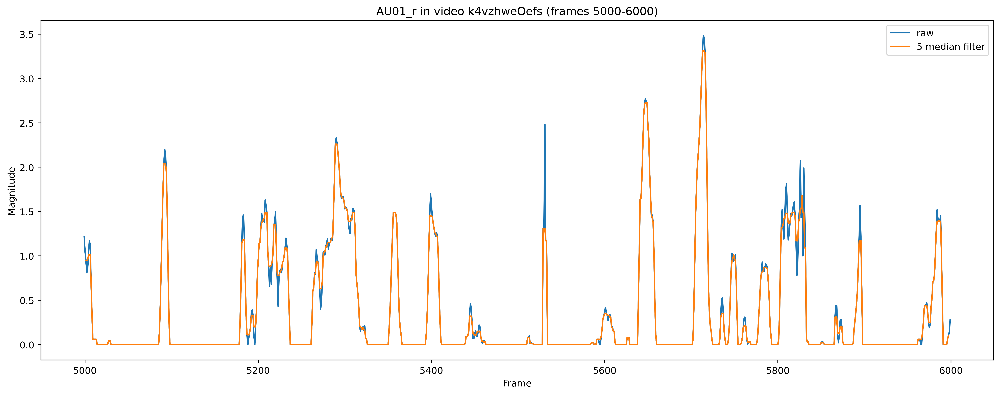

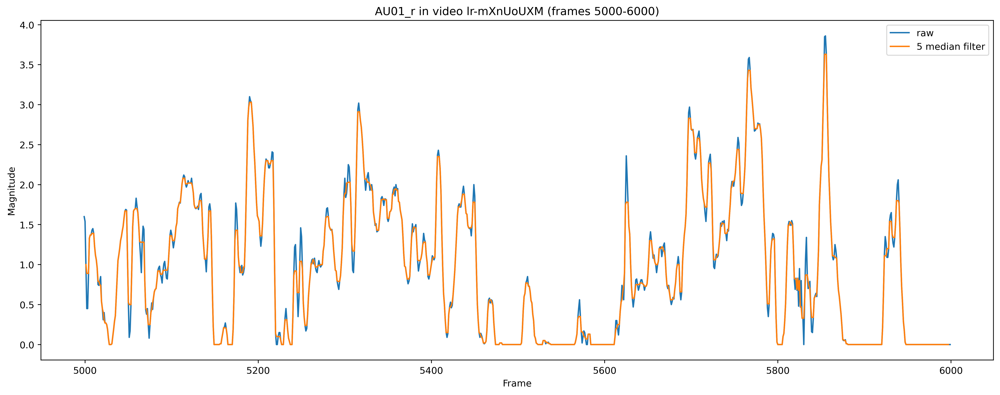

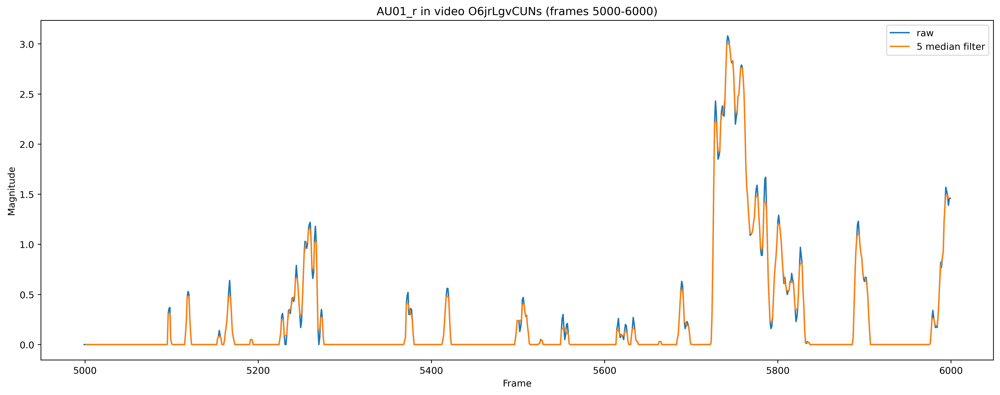

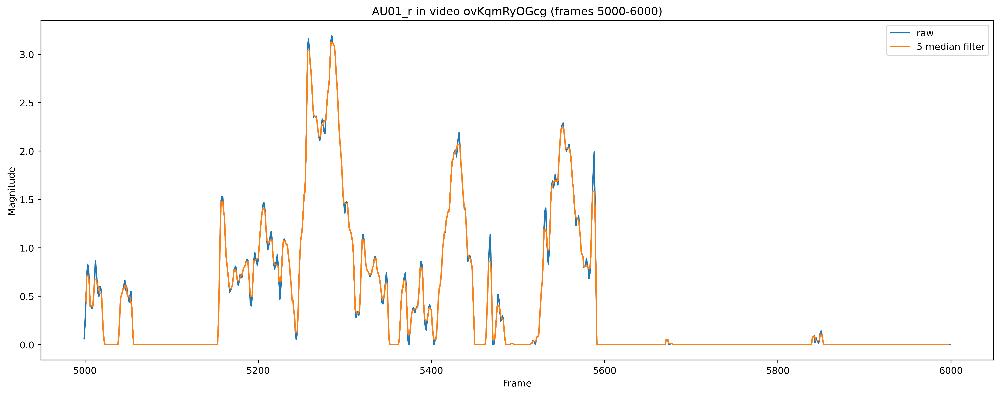

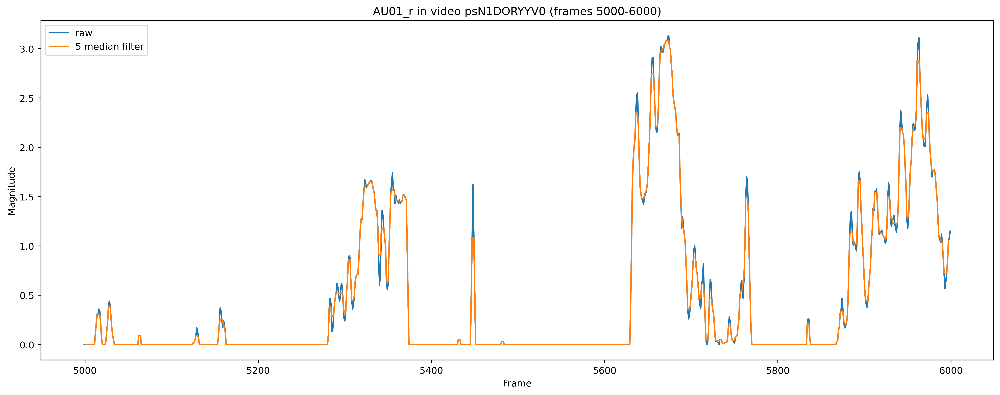

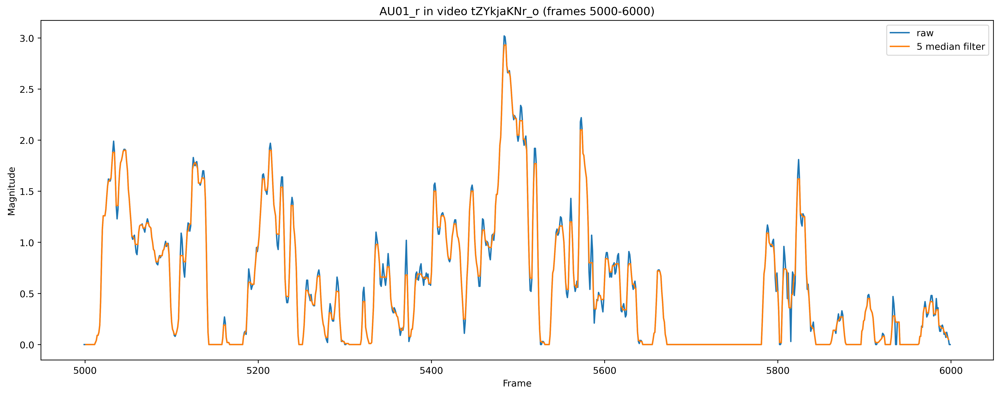

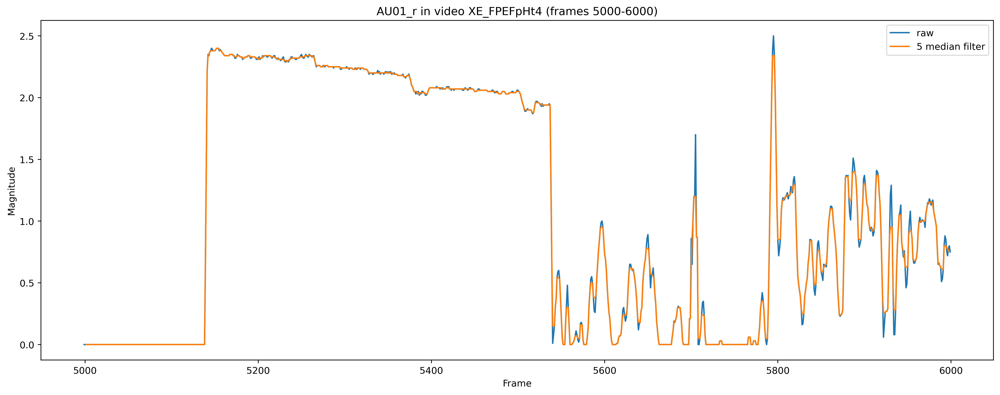

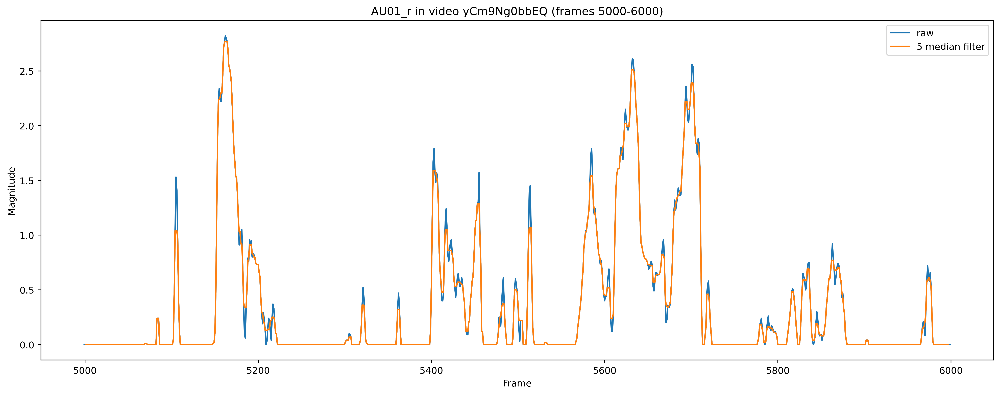

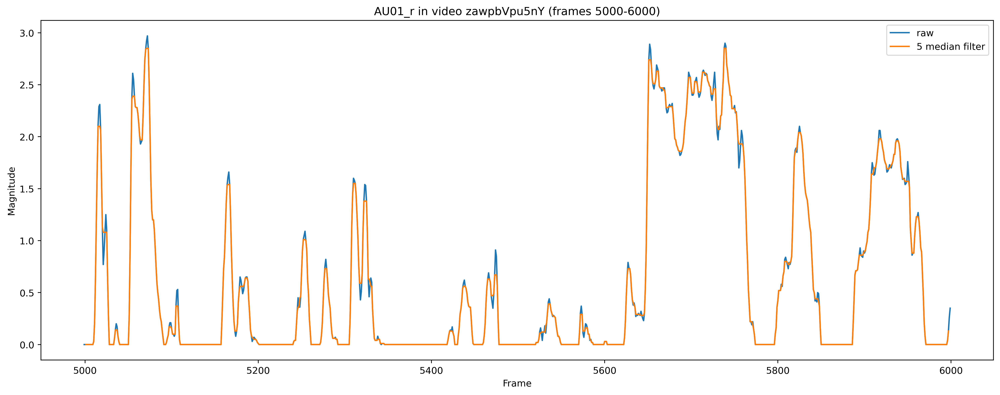

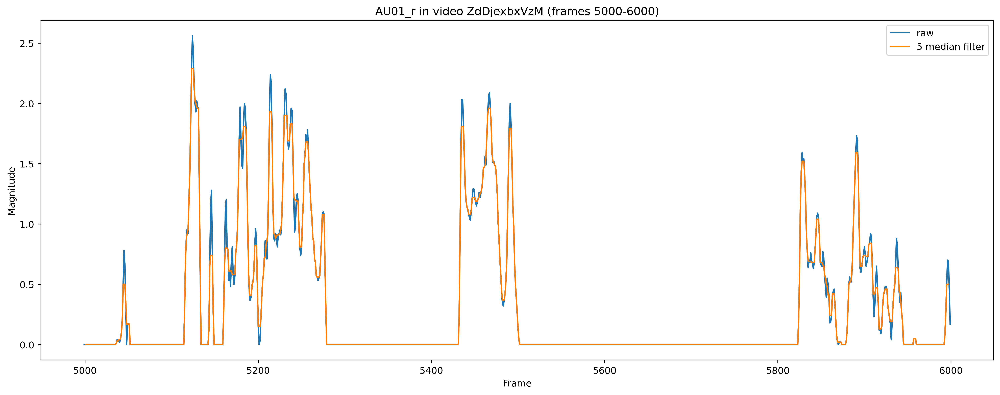

In [11]:
for i, vid_id in enumerate(video_ids):
    df_i = dfs_video[i]
    plot_AU(df_i, vid_id, plot_window=[5000, 6000], AU='01_r', median_filters=[5])

Filtered non-success frames

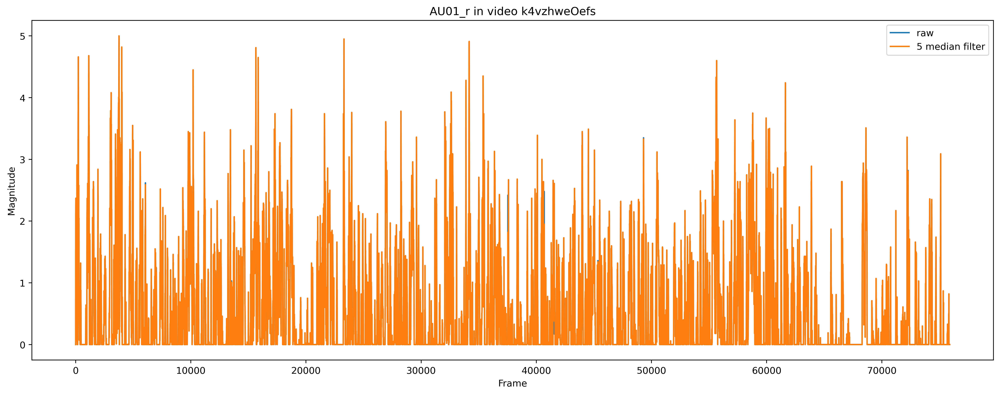

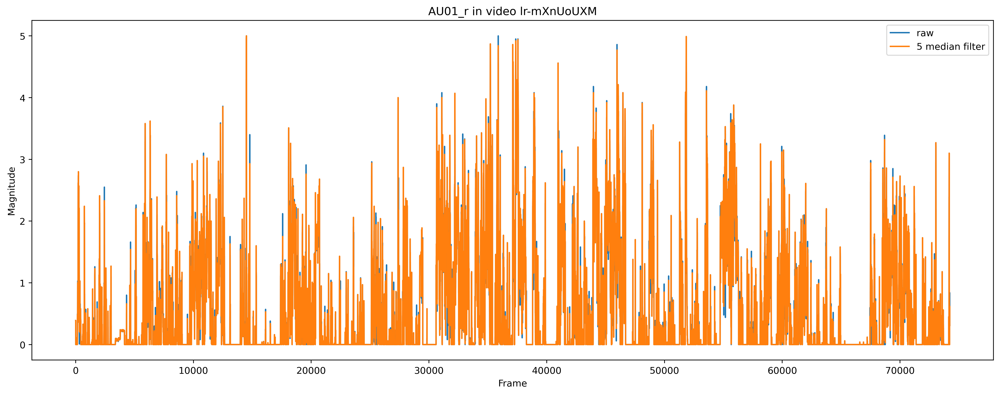

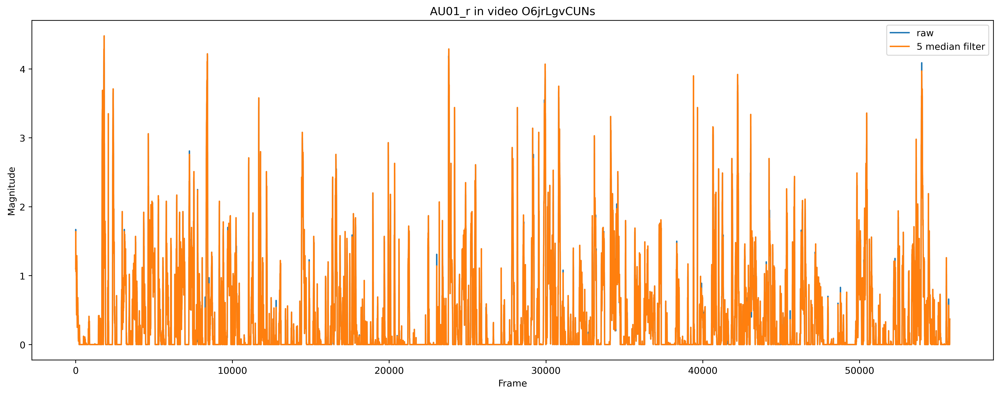

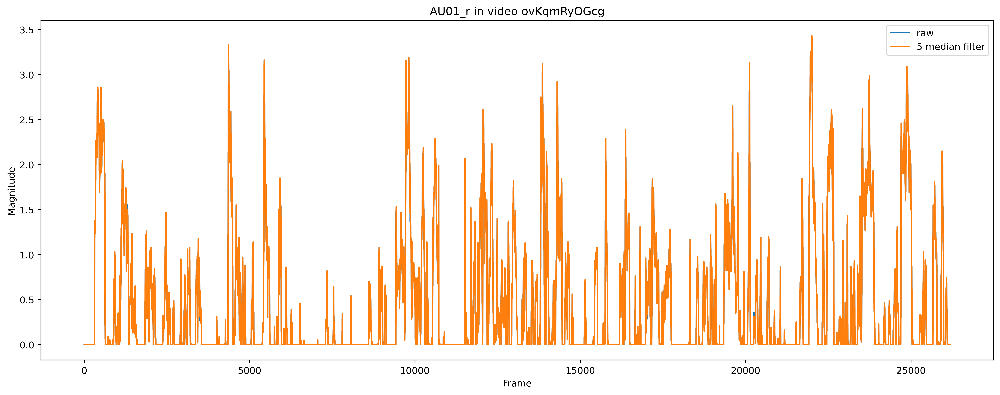

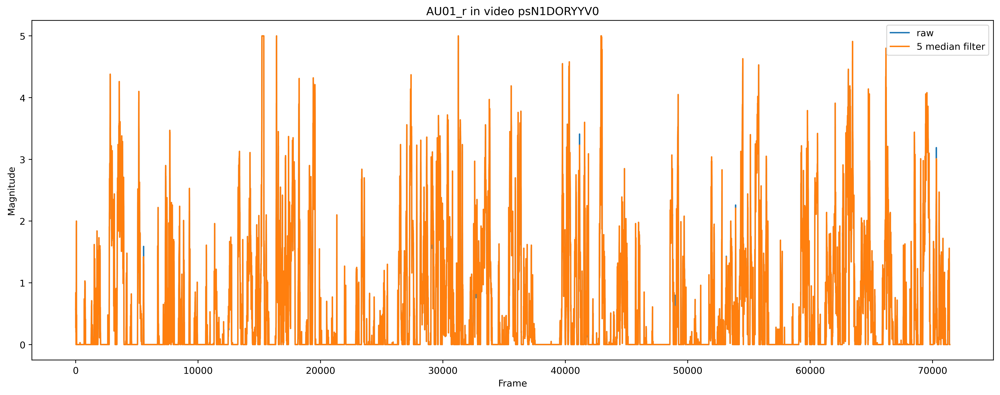

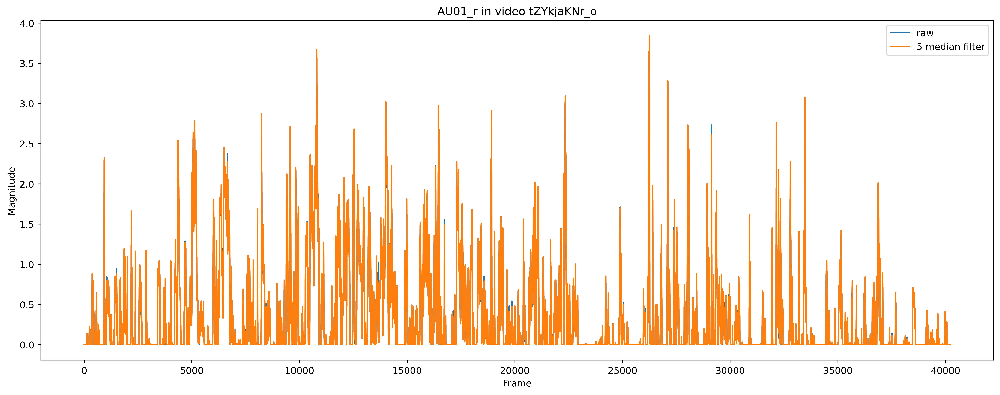

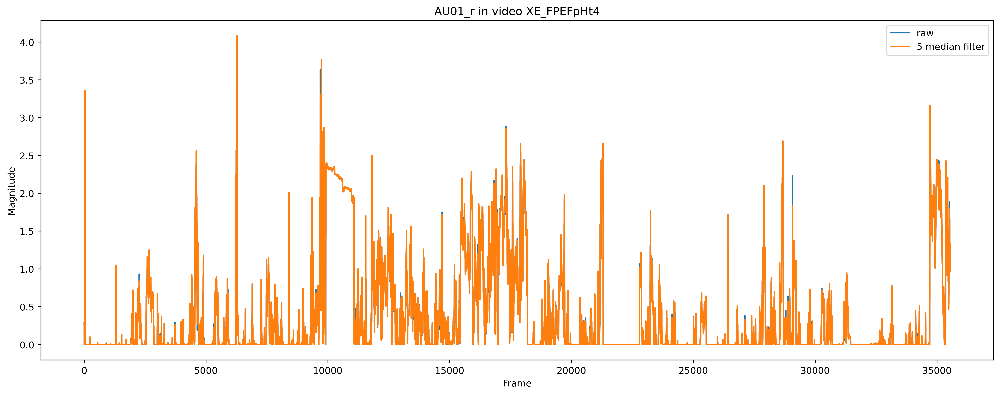

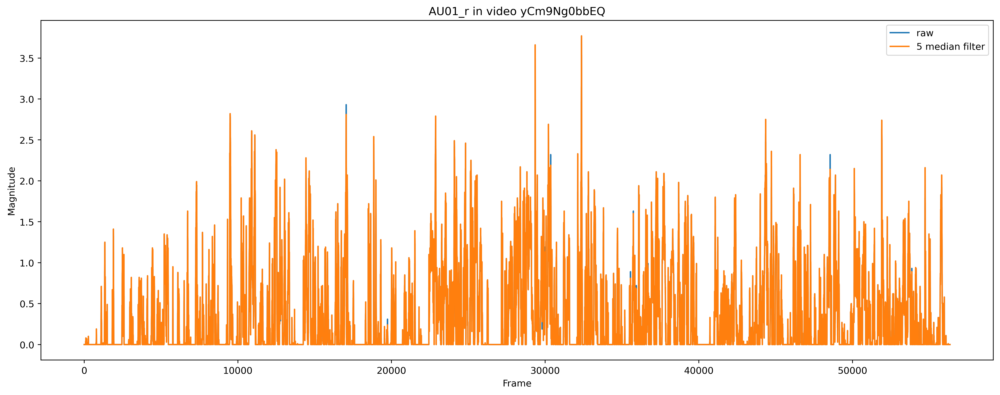

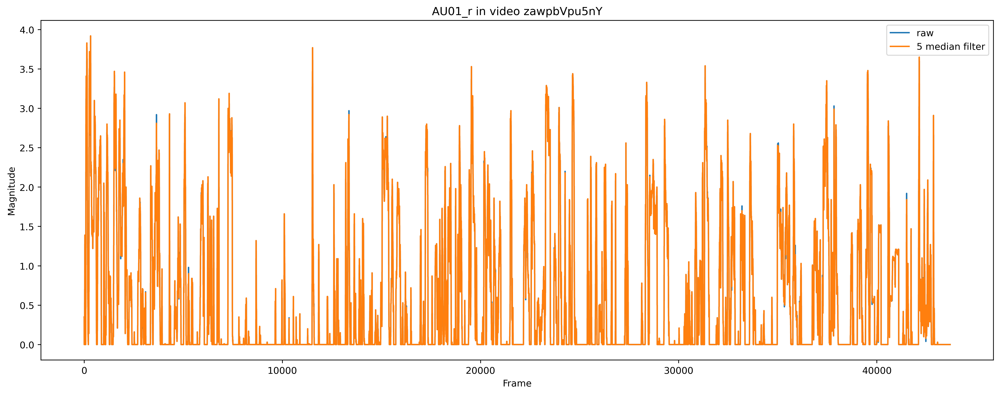

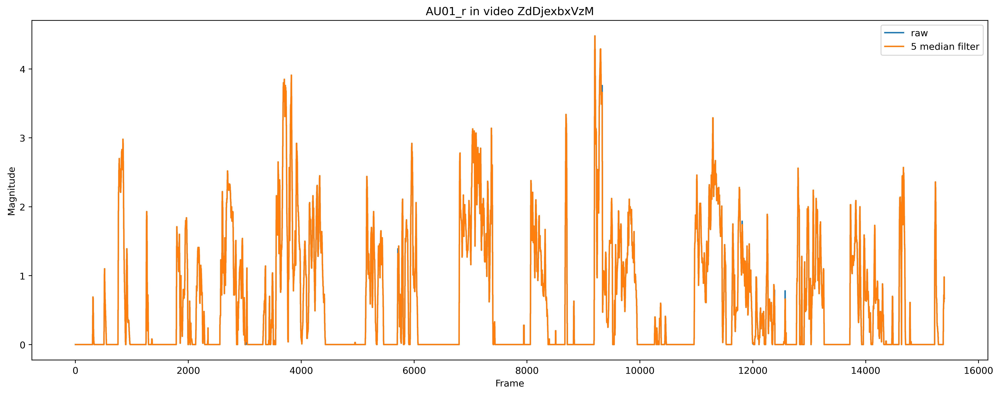

In [13]:
for i, vid_id in enumerate(video_ids):
    df_i = dfs_merged[i]
    plot_AU(df_i, vid_id, plot_window=None, AU='01_r', median_filters=[5])

### Audio features

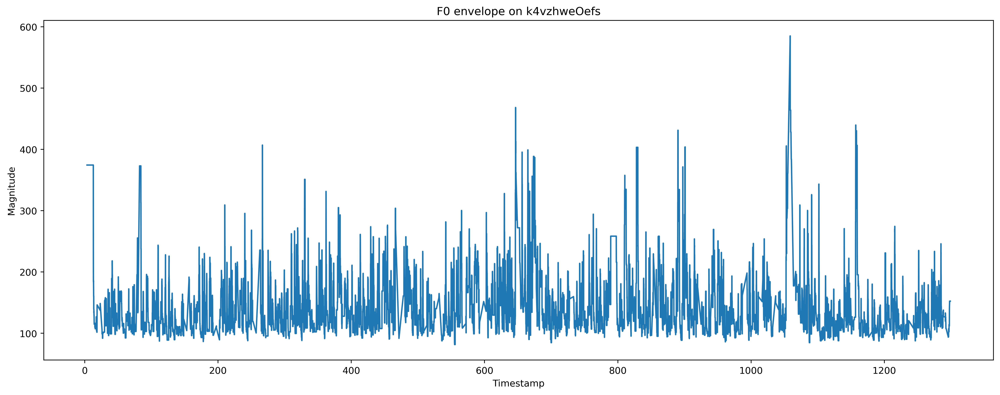

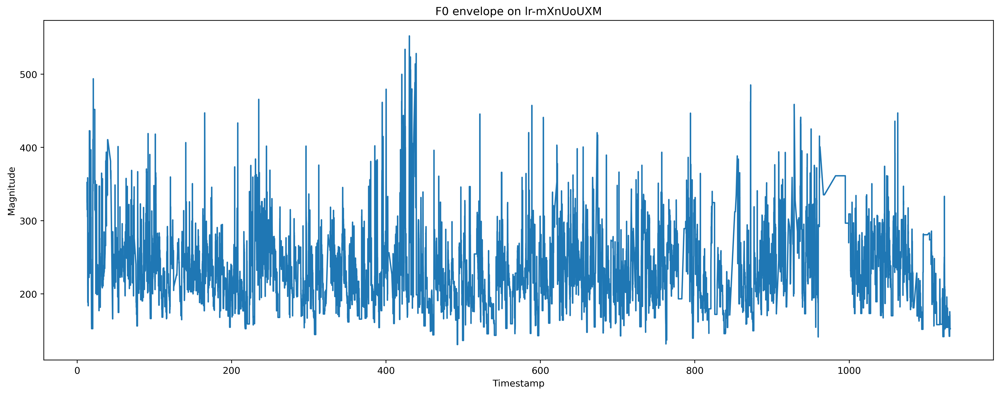

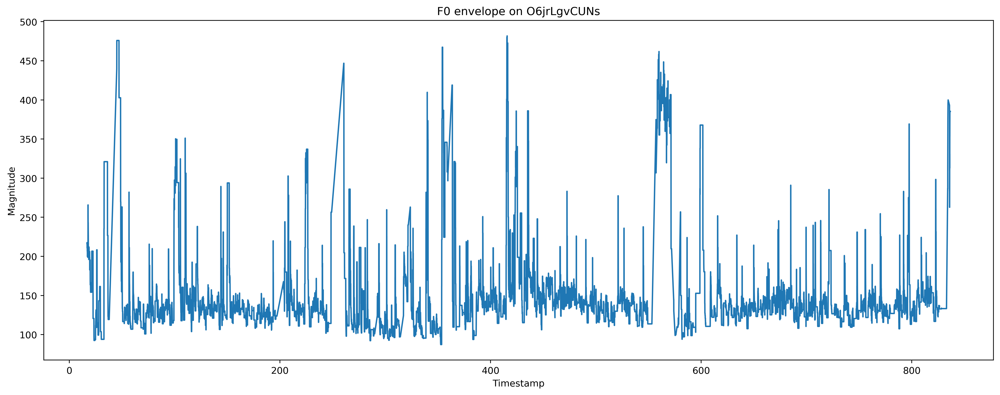

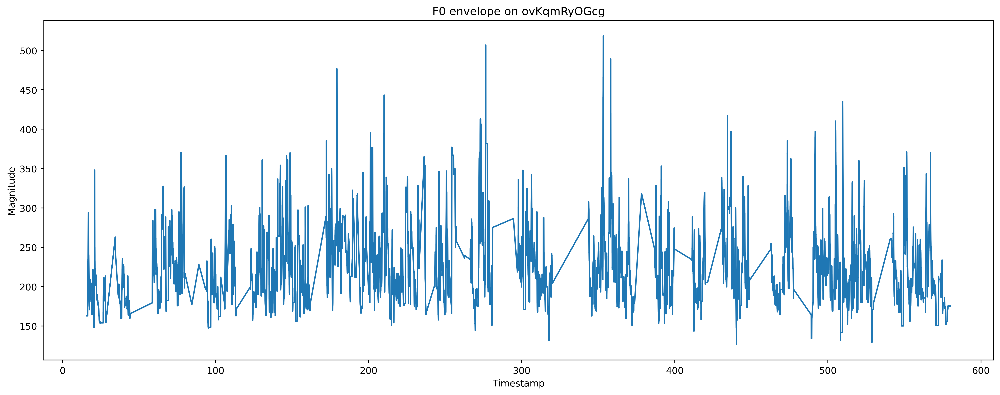

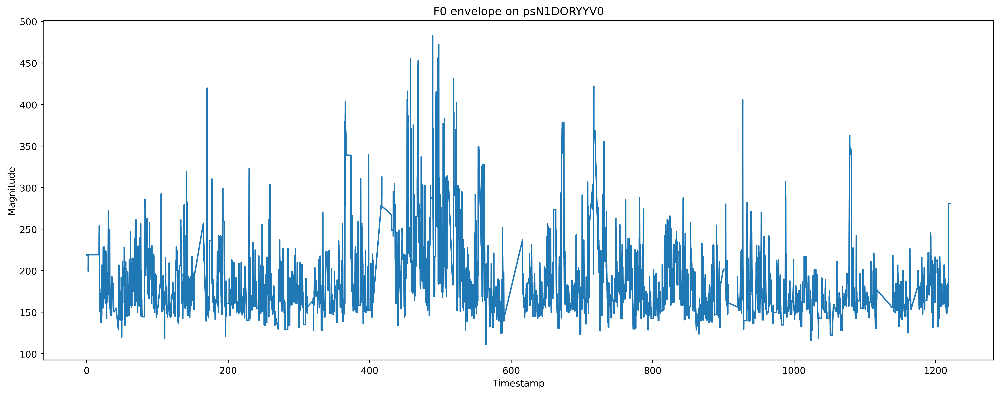

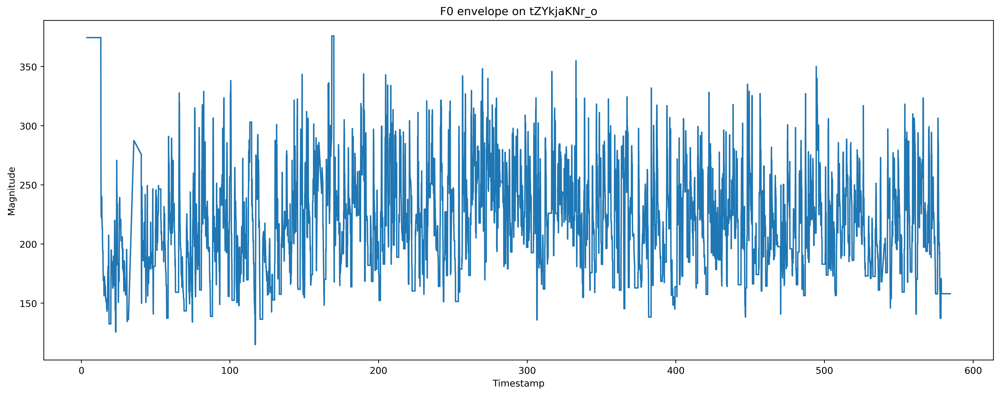

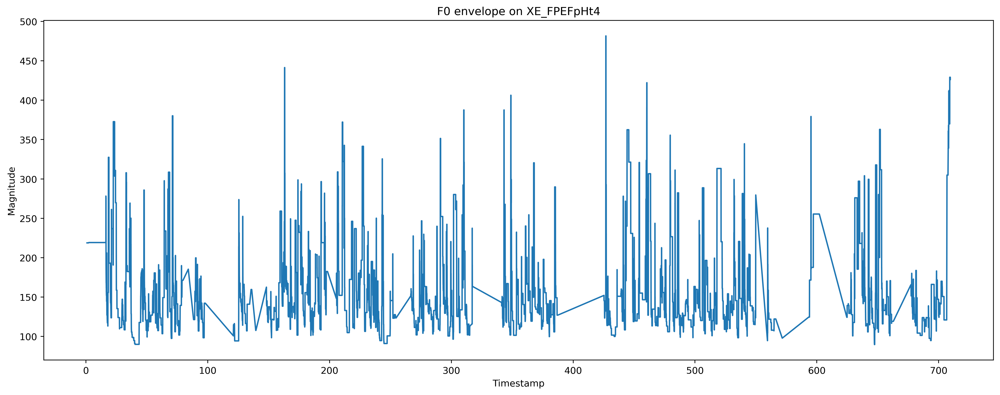

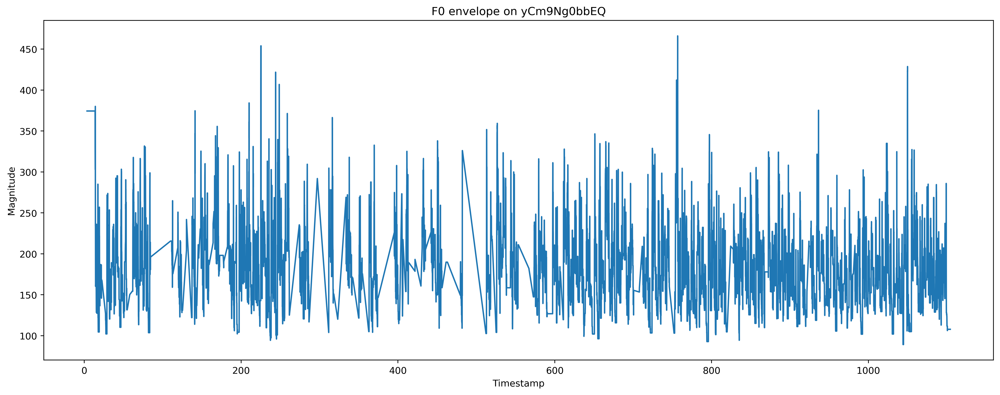

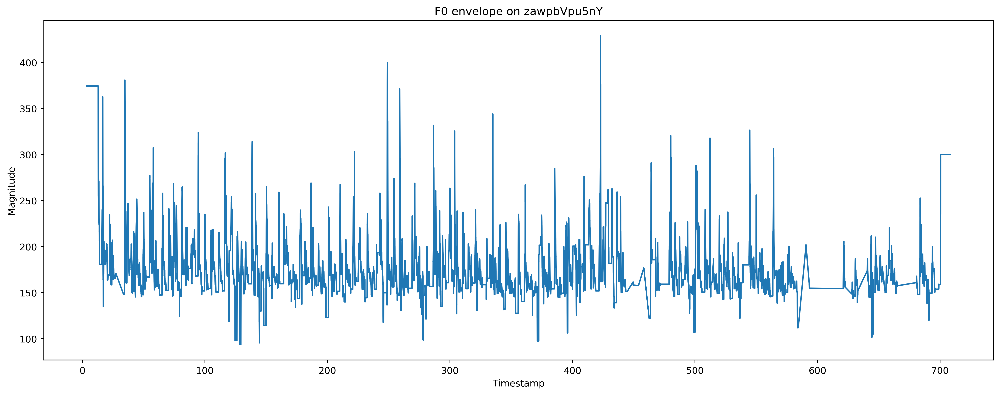

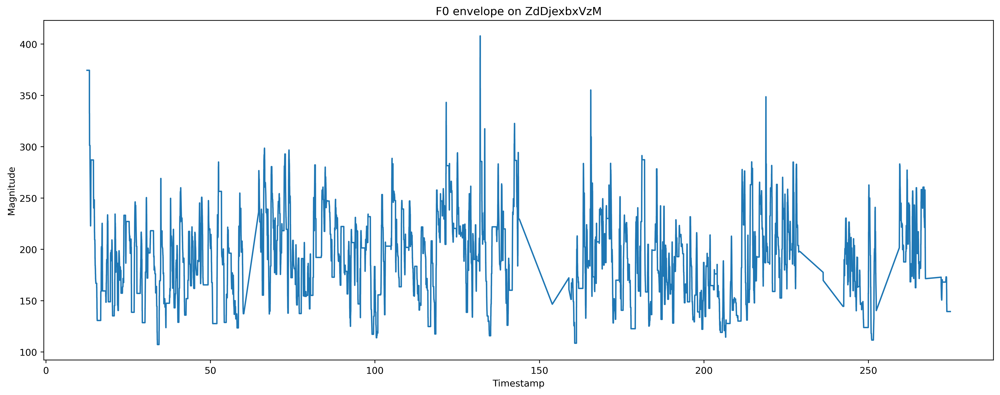

In [16]:
for i, vid_id in enumerate(video_ids):
    df_i = dfs_merged[i]
    
    fig, ax = plt.subplots(figsize=(15, 6), tight_layout=True, dpi=400.0, facecolor='white')
    ax.plot(df_i['timestamp'], df_i['F0finEnv'])
    ax.set_title(f'F0 envelope on {vid_id}')
    ax.set_ylabel('Magnitude')
    ax.set_xlabel('Timestamp')
    plot_fname = f'{vid_id}_F0'
    os.makedirs(figures_dir, exist_ok=True)
    
    # Save figure and show
    fig.savefig(os.path.join(figures_dir, plot_fname))
    plt.show()